# Add Libraries

In [4]:
import os
import time
import numpy as np
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D


from core import core_global as core
from core.spike_monitor import SpikeMonitor
from core.voltage_monitor import VoltageMonitor
from core.weight_matrix_monitor import WeightMatrixMonitor
from layers.rewiring_connection import RewiringConnection
from models.poisson_pattern_group import PoissonPatternGroup
from utils import utils as utils

plt.rcParams.update({
    'font.size': 8,          # Default font size
    'axes.titlesize': 10,    # Title font size
    'axes.labelsize': 9,     # Axis labels font size
    'xtick.labelsize': 8,    # X-axis tick labels font size
    'ytick.labelsize': 8,    # Y-axis tick labels font size
    'legend.fontsize': 8,    # Legend font size
    'figure.titlesize': 10   # Figure title font size
})
plt.rcParams['font.family'] = 'sans-serif'

dCaAP_color = plt.get_cmap('Pastel2')(0)
dCaAP_error_color = plt.get_cmap('Set2')(0)
NMDA_color = plt.get_cmap('Pastel2')(1)
NMDA_error_color = plt.get_cmap('Set2')(1)

num_branches = 12

# Set the address of the Result folder

In [7]:
# model_name = "Limbacher"
model_name = "Gidon_dend"


simulation_date = "241126_212200"
trial_number = 8

# simulation_date = "241127_002127"
# trial_number = 9

# exp_name = "rewiring_ex1"
exp_name = "rewiring_ex2"
# exp_name = "rewiring_ex3"
# exp_name = "rewiring_ex4"


exp_aspect = 'Random_input'
# exp_aspect = 'coactive2'
# exp_aspect = 'Sequential_input'

num_branches = 12

# Membrane potentials before and after learning

In [10]:
branches_to_plot = [3,6,9,11]
fig, axs = plt.subplots(5,2,figsize=(7, 6),dpi = 1200)

#############################Input
with open(f'results/{exp_name}/{exp_aspect}/{model_name}/{simulation_date}/{trial_number}/data/input.0.ras', 'r') as f:
    data_observed = f.read().splitlines(True)

active_cell = []
time_list=[]
color_list = []
assembely_colors_plotting = range(8)

for component in data_observed[1:]:
        comps = component.split(' ')
        active_cell.append(int(comps[1]))
        color_list.append(assembely_colors_plotting[int(active_cell[-1]/40)])
        time_list.append(float(comps[0]))
time_list = np.array(time_list)
cut_time= np.where((time_list[1:]-time_list[:-1]) > 10)[0][0] +1                         
d1 = {'cell_num': active_cell[:cut_time] , 'time(s)': time_list[:cut_time],'color':color_list[:cut_time]}
d2 = {'cell_num': active_cell[cut_time:] , 'time(s)': time_list[cut_time:],'color':color_list[cut_time:]}

Activity_data_1 = pd.DataFrame(data=d1)
Activity_data_2 = pd.DataFrame(data=d2)

color_palette = "muted"
sns.scatterplot(ax=axs[0][0],data=Activity_data_1, x="time(s)", y="cell_num",s = 0.5,hue = 'color', palette = color_palette,legend=False)
axs[0][0].set_title('Before Training')
sns.scatterplot(ax=axs[0][1],data=Activity_data_2, x="time(s)", y="cell_num",s = 0.5,hue = 'color', palette = color_palette,legend=False)
axs[0][1].set_title('After Training')
legend_handles = [Line2D([0], [0], marker='o', color='w', markerfacecolor=sns.color_palette(color_palette)[i], markersize=8, label=f'{i+1}') for i in range(8)]
# axs[0][1].legend(handles=legend_handles, loc='center', title='Assemblies', bbox_to_anchor=(0, 2), ncol=4)
fig.legend(handles=legend_handles, loc='lower center', title='Assembly',bbox_to_anchor=(0.5, 0.91), ncol=4)

###########################branches
for plot_ind in range(1,5):
    
        with open(f'results/{exp_name}/{exp_aspect}/{model_name}/{simulation_date}/{trial_number}/data/branch{branches_to_plot[plot_ind-1]}.0.mem', 'r') as f:
            data_observed = f.read().splitlines(True)

        potential_stick = [] 
        obsevation_time = []
        for component in data_observed[1:]:
                comps = component.split(' ')
                potential_stick.append(float(comps[1]))
                obsevation_time.append(float(comps[0]))

        obsevation_time = np.array(obsevation_time)
        cut_time= np.where((obsevation_time[1:]-obsevation_time[:-1]) > 10)[0][0] +1
        axs[plot_ind][0].plot(obsevation_time[:cut_time],potential_stick[:cut_time],linewidth= 0.5)#,label = f'branch{plot_ind}')
        axs[plot_ind][1].plot(obsevation_time[cut_time:],potential_stick[cut_time:],linewidth= 0.5)



     


    ##########################Soma

# with open(f'results/{exp_name}/{exp_aspect}/{model_name}/{simulation_date}/{trial_number}/data/soma.0.mem', 'r') as f:
#     data_observed = f.read().splitlines(True)

# potential_stick = [] 
# obsevation_time = []
# for component in data_observed[1:]:
#         comps = component.split(' ')
#         potential_stick.append(float(comps[1]))
#         obsevation_time.append(float(comps[0]))
        
# obsevation_time = np.array(obsevation_time)
# cut_time= np.where((obsevation_time[1:]-obsevation_time[:-1]) > 10)[0][0] +1
# axs[5][0].plot(obsevation_time[:cut_time],potential_stick[:cut_time],label="Soma",color = 'r',linewidth= 0.5)
# axs[5][1].plot(obsevation_time[cut_time:],potential_stick[cut_time:],label="Soma",color = 'r',linewidth= 0.5)


#### Print labels
# axs[5][0].set_ylabel('$V_{Soma}$\n')
axs[-1][0].set_xlabel("Time(s)")
axs[-1][1].set_xlabel("Time(s)")
axs[0][0].set_ylabel("Input cell\nindex")
axs[0][1].set_ylabel("")
axs[0][0].set_xlabel("")
axs[0][1].set_xlabel("")
for i in range(1,5):
    axs[i][0].set_ylabel('$V_{branch}$'+" "+f'$_{str(i)}$\n')


### Print ticks
for i in range(5): 
    if i == 0:
        axs[i][1].set_yticks([])
        axs[i][0].set_yticks([3,160,320],['0','160','320'])
        axs[i][0].set_xticks([])
        axs[i][1].set_xticks([])
    else: 
        axs[i][0].set_yticks([-70,0, 70],['-70','0','70'])
        axs[i][1].set_yticks([])
        axs[i][1].set_xticks([])
        axs[i][0].set_xticks([])
        
# axs[-1][0].set_yticks([-70,-35,0],['-70','-35','0'])
axs[-1][1].set_xticks(range(990,1001,2))
axs[-1][0].set_xticks(range(0,11,2))
axs[0][0].set_xticks([])
axs[0][1].set_xticks([])



#### Set x and y limits
for i in range(5):
    axs[i][0].set_xlim(0,10)
    axs[i][1].set_xlim(990,1000)
for i in range(1,4):
    axs[i][0].set_ylim(-75,85)
    axs[i][1].set_ylim(-75,85)
axs[0][0].set_ylim(0,320)
axs[0][1].set_ylim(0,320)
# axs[-1][0].set_ylim(-75,0)
# axs[-1][1].set_ylim(-75,0)
# plt.tight_layout()
# fig.savefig("Figures/coactive2_V_trace.pdf", format='pdf')
fig.savefig("Figures/pdf/"+exp_aspect+"_V_trace.pdf", format='pdf',bbox_inches='tight')
fig.savefig("Figures/pdf/"+exp_aspect+"_V_trace.png", format='png',bbox_inches='tight')

fig.savefig("Figures/svg/"+exp_aspect+"_V_trace.svg", format='svg',bbox_inches='tight')

# Weights and connections evolution

In [12]:
# model_name = "Limbacher"
model_name = "Gidon_dend"

# coactive
# simulation_date = "241127_002127"
# trial_number = 9

# Random
simulation_date = "241126_212200"
trial_number = 8


# exp_name = "rewiring_ex1"
exp_name = "rewiring_ex2"
# exp_name = "rewiring_ex3"
# exp_name = "rewiring_ex4"


exp_aspect = 'Random_input'
# exp_aspect = 'coactive2'
# exp_aspect = 'Sequential_input'

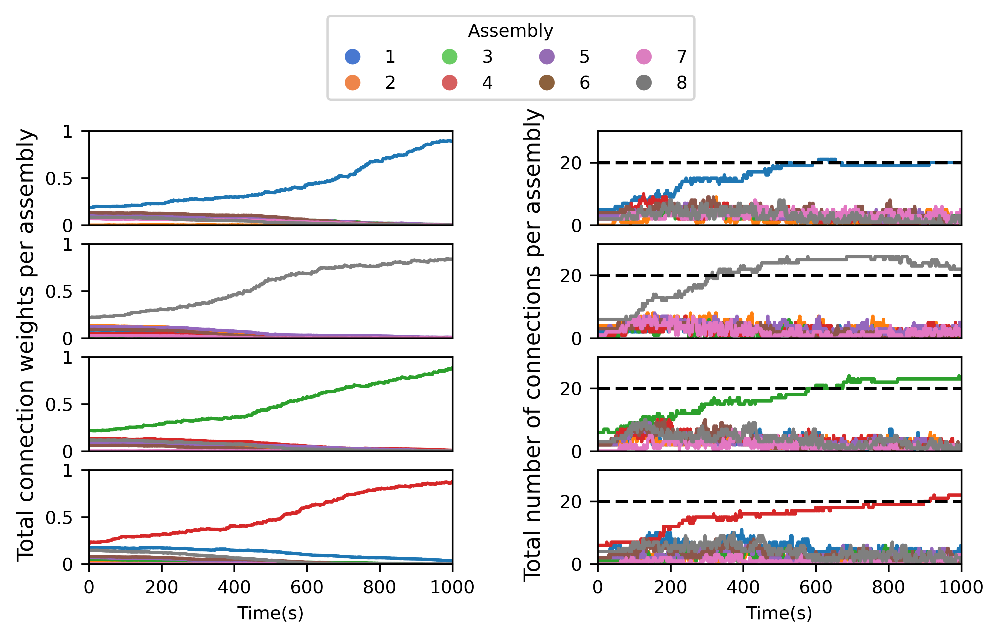

In [13]:
sim_date = f"{simulation_date}/{trial_number}"
input_directory = os.path.join("results", exp_name,exp_aspect,model_name, sim_date, "data")
   

with open(os.path.join(input_directory, "weights.0.dat"), "rb") as f:
        lines = f.readlines()
lines = lines[2:]

time_series =np.arange(0,3333,3)
W_T = []
Nsyn_T= []
for q in time_series:
    weights_t = np.loadtxt(lines[(num_branches+1)*q +1:(num_branches+1)*(q+1)])
#     print(np.shape(weights_t))
    weight_br_assemb = np.zeros((num_branches,8))
    Nsyn_br_assemb = np.zeros((num_branches,8))
    for j in range(num_branches):
        for i in range(8):
            weight_br_assemb[j][i] = np.sum(weights_t[j][i * 40:(i+1)*40])
            Nsyn_br_assemb[j][i] = len(np.where(weights_t[j][i * 40:(i+1)*40] > 0)[0])
    W_T.append(weight_br_assemb)
    Nsyn_T.append(Nsyn_br_assemb)
W_T = np.array(W_T)
Nsyn_T = np.array(Nsyn_T)


##########plotting########
branches_to_plot = [3,6,9,11]
fig, axs = plt.subplots(len(branches_to_plot),2,figsize=(7, 3.5),dpi = 600)

########### weights

for i in range(len(branches_to_plot)):
    axs[i][0].plot(time_series/3,W_T[:,branches_to_plot[i],:])
    axs[i][0].set_ylim(0,160)
    axs[i][0].set_xlim(0,1000)

    axs[i][0].set_yticks(range(0,161,80),['0','0.5','1'])
    axs[i][0].set_xticks([])
    
    axs[i][1].plot(time_series/3,Nsyn_T[:,branches_to_plot[i],:])
    axs[i][1].hlines(20,0,1000,linestyle = '--',color = 'black',label= 'limit')
    axs[i][1].set_xticks([])
    axs[i][1].set_ylim(0,30)
    axs[i][1].set_xlim(0,1000)
    
axs[-1][0].set_xticks(range(0,1001,200))  
axs[-1][1].set_xticks(range(0,1001,200))    

fig.text(0.07, 0.5, 'Total connection weights per assembly', rotation=90, ha='center', va='center', fontsize=plt.rcParams['axes.titlesize'])
fig.text(0.53, 0.5, 'Total number of connections per assembly', rotation=90, ha='right', va='center', fontsize=plt.rcParams['axes.titlesize'])

axs[-1][0].set_xlabel('Time(s)')  
axs[-1][1].set_xlabel('Time(s)')

color_palette = sns.color_palette("muted")
legend_handles = [Line2D([0], [0], marker='o', color='w', markerfacecolor=color_palette[i], markersize=8, label=f'{i + 1}') for i in range(8)]

# Add legend to the upper center of the figure
fig.legend(handles=legend_handles, loc='lower center',bbox_to_anchor=(0.5, 0.92), title='Assembly', ncol=4)
plt.subplots_adjust(wspace=0.4)

fig.savefig("Figures/svg/"+exp_aspect+"_weights.svg", format='svg',bbox_inches='tight')
fig.savefig("Figures/pdf/"+exp_aspect+"_weights.pdf", format='pdf',bbox_inches='tight')

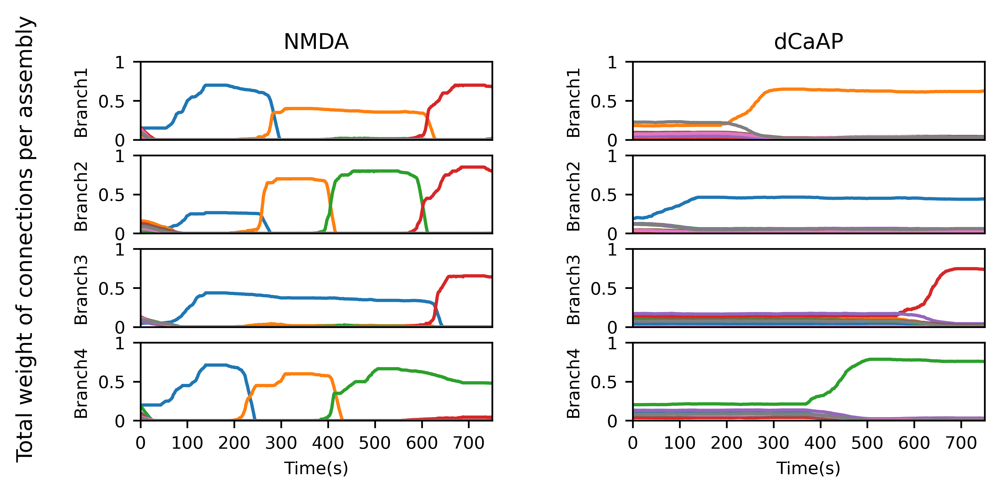

In [14]:
exp_name = "rewiring_ex3"
exp_aspect = 'Sequential_input'
total_time = 750
branches_to_plot = 4
############################################################################
model_name = "Limbacher"
simulation_date = "241126_215359"
trial_number = 1
sim_date = f"{simulation_date}/{trial_number}"
input_directory = os.path.join("results", exp_name,exp_aspect,model_name, sim_date, "data")
   

with open(os.path.join(input_directory, "weights.0.dat"), "rb") as f:
        lines = f.readlines()
lines = lines[2:]

time_series =np.arange(0,total_time*3,3)
W_T = []
Nsyn_T= []
for q in time_series:
    weights_t = np.loadtxt(lines[(num_branches+1)*q +1:(num_branches+1)*(q+1)])
#     print(np.shape(weights_t))
    weight_br_assemb = np.zeros((num_branches,8))
    Nsyn_br_assemb = np.zeros((num_branches,8))
    for j in range(num_branches):
        for i in range(8):
            weight_br_assemb[j][i] = np.sum(weights_t[j][i * 40:(i+1)*40])
            Nsyn_br_assemb[j][i] = len(np.where(weights_t[j][i * 40:(i+1)*40] > 0)[0])
    W_T.append(weight_br_assemb)
    Nsyn_T.append(Nsyn_br_assemb)
W_T = np.array(W_T)
Nsyn_T = np.array(Nsyn_T)


##########plotting########
fig, axs = plt.subplots(branches_to_plot,2,figsize=(7, 3),dpi = 600)

########### weights
br_list = [0,5,6,11]
for i in range(branches_to_plot):
    axs[i][0].plot(time_series/3,W_T[:,br_list[i],:])
    axs[i][0].set_ylim(0,160)
    axs[i][0].set_xlim(0,total_time)
    axs[i][0].set_ylabel(f'Branch{i+1}')
    axs[i][0].set_yticks(range(0,161,80),['0','0.5','1'])
    axs[i][0].set_xticks([])
      


#################################### dCaAP model ##########################
model_name = "Gidon_dend"
simulation_date = "241126_213714"
trial_number = 8
sim_date = f"{simulation_date}/{trial_number}"
input_directory = os.path.join("results", exp_name,exp_aspect,model_name, sim_date, "data")

with open(os.path.join(input_directory, "weights.0.dat"), "rb") as f:
        lines = f.readlines()
lines = lines[2:]

time_series =np.arange(0,total_time*3,3)
W_T = []
Nsyn_T= []
for q in time_series:
    weights_t = np.loadtxt(lines[(num_branches+1)*q +1:(num_branches+1)*(q+1)])
#     print(np.shape(weights_t))
    weight_br_assemb = np.zeros((num_branches,8))
    Nsyn_br_assemb = np.zeros((num_branches,8))
    for j in range(num_branches):
        for i in range(8):
            weight_br_assemb[j][i] = np.sum(weights_t[j][i * 40:(i+1)*40])
            Nsyn_br_assemb[j][i] = len(np.where(weights_t[j][i * 40:(i+1)*40] > 0)[0])
    W_T.append(weight_br_assemb)
    Nsyn_T.append(Nsyn_br_assemb)
W_T = np.array(W_T)
Nsyn_T = np.array(Nsyn_T)

########### weights
br_list = [1,2,4,5]
for i in range(branches_to_plot):
    axs[i][1].plot(time_series/3,W_T[:,br_list[i],:])
    axs[i][1].set_ylim(0,160)
    axs[i][1].set_xlim(0,total_time)
    axs[i][1].set_ylabel(f'Branch{i+1}')

    axs[i][1].set_yticks(range(0,161,80),['0','0.5','1'])#range(0,161,80),['0','0.5','1'])
    axs[i][1].set_xticks([])
    
    
axs[-1][0].set_xticks(range(0,total_time+1,100))  
axs[-1][1].set_xticks(range(0,total_time+1,100)) 
axs[-1][0].set_xlabel('Time(s)')  
axs[-1][1].set_xlabel('Time(s)')
axs[0][0].set_title('NMDA')
axs[0][1].set_title('dCaAP')
fig.text(0.02, 0.5, 'Total weight of connections per assembly', rotation=90, ha='center', va='center', fontsize=plt.rcParams['axes.titlesize'])

color_palette = sns.color_palette("muted")
legend_handles = [Line2D([0], [0], marker='o', color='w', markerfacecolor=color_palette[i], markersize=8, label=f'{i + 1}') for i in range(8)]


# Add legend to the upper center of the figure
# fig.legend(handles=legend_handles, loc='lower center',bbox_to_anchor=(0.5, 0.92), title='Assembly', ncol=4)
plt.subplots_adjust(wspace=0.4)

fig.savefig("Figures/svg/"+exp_aspect+"_weights.svg", format='svg',bbox_inches='tight')
fig.savefig("Figures/pdf/"+exp_aspect+"_weights.pdf", format='pdf',bbox_inches='tight')



# Run the test Phase on the Results 

In [92]:
# model_name = "Limbacher"
model_name = "Gidon_dend"
from models.Gidon_mc_lif_group_current import McLifGroup

# coactive
# simulation_date = "241127_002127"
# trial_number = 9

# Random
simulation_date = "241126_204651"
trial_number = 1


# exp_name = "rewiring_ex1"
exp_name = "rewiring_ex2"
# exp_name = "rewiring_ex3"
# exp_name = "rewiring_ex4"


exp_aspect = 'Random_input'
# exp_aspect = 'coactive2'
# exp_aspect = 'Sequential_input'



In [104]:
def main(simulation_time, experiment, sim_date, assemblies,
         assembly_neurons_idc, config, output_directory):

    input_params = config["input_parameters"]
    connection_params = config["connection_parameters"]
    neuron_params = config["neuron_parameters"]
#     input_params["pattern_duration"] = 0.7
    simulation_time_per_pattern = (input_params["pattern_duration"] +
                                   input_params["pattern_delay"])
    input_params['rate'] = 35 ### 35Hz
    input_params['num_simultaneous_assemblies'] = 1
    input_params['num_simultaneous_noise_assemblies'] = 1



    # Initialize the simulation environment.
    core.init(directory=output_directory)

    # Set the random seed.
    core.kernel.set_master_seed(config["master_seed"])

    # Create input neurons.
    inp = PoissonPatternGroup(input_params["num_inputs"], input_params["rate"],
                              input_params["rate_bg"], params=input_params)

    # Create the neuron.
    neuron = McLifGroup(1, neuron_params["num_branches"], neuron_params)

    # Connect input to neuron.
    conn = RewiringConnection(inp, neuron, neuron.branch.syn_current,
                              connection_params)
    conn.learn = False

    # Create some monitors which will record the simulation data.
    SpikeMonitor(neuron, core.kernel.fn("test_output", "ras"))
    SpikeMonitor(inp, core.kernel.fn("test_input", "ras"))
    VoltageMonitor(neuron.soma, 0, core.kernel.fn("test_soma", "mem"),
                   paste_spikes=True, paste_spikes_from=neuron)
    for i in range(neuron_params["num_branches"]):
        VoltageMonitor(neuron.branch, (i, 0),
                       core.kernel.fn("test_branch", "mem", i))

    # Now simulate the model.
#     conn.set_weights(weights_pre)
#     for assembly in assemblies:
#         inp.set_assemblies(assembly)
#         inp.set_assembly_neurons_idc(assembly_neurons_idc)
#         core.kernel.run_chunk(
#             simulation_time_per_pattern, 0, simulation_time)

    # conn.set_weights(weights_post)
    # for assembly in range(5):
    #     inp.set_assemblies(assembly)
    #     inp.set_assembly_neurons_idc(assembly_neurons_idc)
    #     core.kernel.run_chunk(
            # simulation_time_per_pattern, 0, simulation_time)

    conn.set_weights(weights_post)
    for repeat in range(30):
        assembly = np.random.randint(0,4)
        inp.set_assemblies(assembly)
        inp.set_assembly_neurons_idc(assembly_neurons_idc)
        core.kernel.run_chunk(
            simulation_time_per_pattern, 0, simulation_time)
        
#     for assembly in range(8):
#         inp.set_assemblies(assembly)
#         inp.set_assembly_neurons_idc(assembly_neurons_idc)
#         core.kernel.run_chunk(
#             simulation_time_per_pattern, 0, simulation_time)

    core.kernel.run_chunk(input_params["pattern_delay"], 0,
                               simulation_time)
# # #########coactive assemblies
#     conn.set_weights(weights_post)  
    
#     inp.set_assemblies([1,3])
#     inp.set_assembly_neurons_idc(assembly_neurons_idc)
#     core.kernel.run_chunk(simulation_time_per_pattern, 0, simulation_time)
        
#     inp.set_assemblies([2,4])
#     inp.set_assembly_neurons_idc(assembly_neurons_idc)
#     core.kernel.run_chunk(simulation_time_per_pattern, 0, simulation_time)
    

    
#     inp.set_assemblies([5,7])
#     inp.set_assembly_neurons_idc(assembly_neurons_idc)
#     core.kernel.run_chunk(simulation_time_per_pattern, 0, simulation_time)
    
#     inp.set_assemblies([0,2])
#     inp.set_assembly_neurons_idc(assembly_neurons_idc)
#     core.kernel.run_chunk(simulation_time_per_pattern, 0, simulation_time)
    
#         inp.set_assemblies([4,6])
#     inp.set_assembly_neurons_idc(assembly_neurons_idc)
#     core.kernel.run_chunk(simulation_time_per_pattern, 0, simulation_time)
    



#     core.kernel.run_chunk(input_params["pattern_delay"], 0,
#                                simulation_time)



if __name__ == '__main__':
    import numpy as np


    sim_date = f"{simulation_date}/{trial_number}"
    master_seed = 13
    simulation_time = 20#3.2

    assemblies = list(range(8))
    assembly_neurons_idc = [i * 40 + np.arange(40) for i in assemblies]

    input_directory = os.path.join("results", exp_name,exp_aspect,model_name, sim_date, "data")

    # Load the configuration file.
    config = utils.load_configuration(os.path.join(
        input_directory, "..", "config_" + exp_name + ".yaml"))
    num_branches = config["neuron_parameters"]["num_branches"]
    config["master_seed"] = master_seed
    if exp_name == "rewiring_ex3":
        assembly_neurons_idc = []
        assembly_neurons_idc = np.loadtxt(os.path.join(input_directory,
                                          "assembly_neurons_idc"),
                                          dtype=np.int)
    else:
        np.save(os.path.join(input_directory, "assembly_neurons_idc"),
                assembly_neurons_idc)

    # Load the weights.
    header_lenght = 3
    with open(os.path.join(input_directory, "weights.0.dat"), "rb") as f:
        lines = f.readlines()
    if ((len(lines)-2)%13) != 0 :
            lines = lines[:-((len(lines)-2)%13)]
    weights_pre = np.loadtxt(lines[header_lenght:num_branches + header_lenght])
    weights_post = np.loadtxt(lines[header_lenght:num_branches + header_lenght])

#     weights_post = np.loadtxt(lines[-num_branches:])

    main(simulation_time, exp_name, sim_date, assemblies,
         assembly_neurons_idc, config, input_directory)


Gidon_dendrites
Graded:  True
dendrite thr: -36.0
Soma thr: -55.0
[===================>     ] 76%

## Protocol

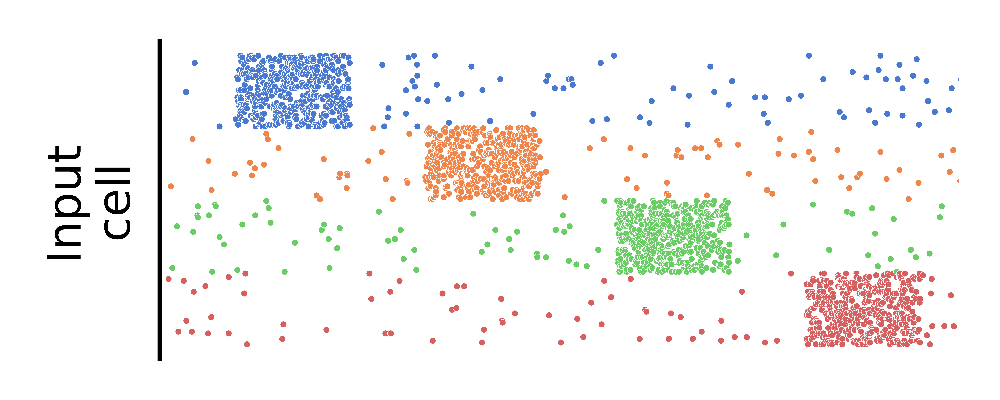

In [88]:
fig, axs = plt.subplots(1,figsize=(2.5,1),dpi = 4000)

#############################Input
with open(f'results/{exp_name}/{exp_aspect}/{model_name}/{simulation_date}/{trial_number}/data/test_input.0.ras', 'r') as f:
    data_observed = f.read().splitlines(True)

active_cell = []
time_list=[]
color_list = []
assembely_colors_plotting = range(8)

for component in data_observed[1:]:
        comps = component.split(' ')
        active_cell.append(int(comps[1]))
        color_list.append(assembely_colors_plotting[int(active_cell[-1]/40)])
        time_list.append(float(comps[0]))
time_list = np.array(time_list)
d1 = {'cell_num': active_cell , 'time(s)': time_list,'color':color_list}

Activity_data_1 = pd.DataFrame(data=d1)

color_palette = "muted"
sns.scatterplot(ax=axs,data=Activity_data_1[Activity_data_1['color']<4], x="time(s)", y="cell_num",s = 1.3 ,hue = 'color', palette = color_palette,legend=False)
# axs[0].set_title('Test')
axs.set_ylabel("Input\ncell",fontsize = 8 , rotation = 90)
axs.set_xlabel("")
legend_handles = [Line2D([0], [0], marker='o', color='w', markerfacecolor=sns.color_palette(color_palette)[i], markersize=8, label=f'{i+1}') for i in range(8)]
# axs[0][1].legend(handles=legend_handles, loc='center', title='Assemblies', bbox_to_anchor=(0, 2), ncol=4)
# fig.legend(handles=legend_handles, loc='lower center', title='Assembly',bbox_to_anchor=(0.5, 0.91), ncol=4)


### Print ticks

axs.set_yticks([])#[3,160,320],['0','160','320'])
axs.set_xticks([])
axs.spines['right'].set_visible(False)
axs.spines['bottom'].set_visible(False)
axs.spines['top'].set_visible(False)



#### Set x and y limits
# for i in range(len(branches_to_plot)+2):
axs.set_xlim(0,2.1)

axs.invert_yaxis()    
# fig.savefig("Figures/coactive2_V_trace.pdf", format='pdf')
fig.savefig("Figures/pdf/before_protocol.pdf", format='pdf',bbox_inches='tight')
fig.savefig("Figures/pdf/before_protocol.png", format='png',bbox_inches='tight')
# 
# fig.savefig("Figures/svg/"+exp_aspect+"_V_trace.svg", format='svg',bbox_inches='tight')

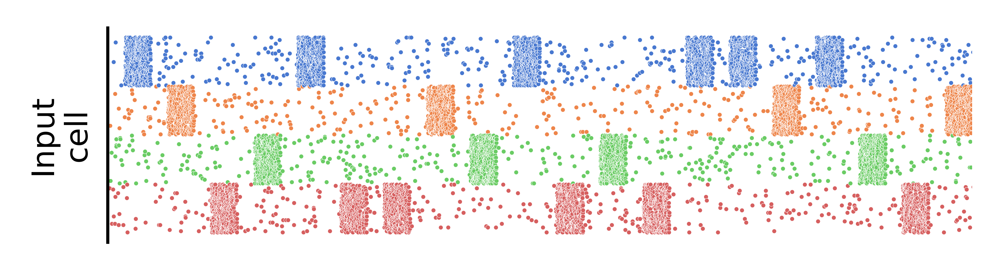

In [112]:
fig, axs = plt.subplots(1,figsize=(4,1),dpi = 1000)

#############################Input
with open(f'results/{exp_name}/{exp_aspect}/{model_name}/{simulation_date}/{trial_number}/data/test_input.0.ras', 'r') as f:
    data_observed = f.read().splitlines(True)

active_cell = []
time_list=[]
color_list = []
assembely_colors_plotting = range(8)

for component in data_observed[1:]:
        comps = component.split(' ')
        active_cell.append(int(comps[1]))
        color_list.append(assembely_colors_plotting[int(active_cell[-1]/40)])
        time_list.append(float(comps[0]))
time_list = np.array(time_list)
d1 = {'cell_num': active_cell , 'time(s)': time_list,'color':color_list}

Activity_data_1 = pd.DataFrame(data=d1)

color_palette = "muted"
sns.scatterplot(ax=axs,data=Activity_data_1[Activity_data_1['color']<4], x="time(s)", y="cell_num",s = 1.3 ,hue = 'color', palette = color_palette,legend=False)
# axs[0].set_title('Test')
axs.set_ylabel("Input\ncell",fontsize = 8 , rotation = 90)
axs.set_xlabel("")
legend_handles = [Line2D([0], [0], marker='o', color='w', markerfacecolor=sns.color_palette(color_palette)[i], markersize=8, label=f'{i+1}') for i in range(8)]
# axs[0][1].legend(handles=legend_handles, loc='center', title='Assemblies', bbox_to_anchor=(0, 2), ncol=4)
# fig.legend(handles=legend_handles, loc='lower center', title='Assembly',bbox_to_anchor=(0.5, 0.91), ncol=4)


### Print ticks

axs.set_yticks([])#[3,160,320],['0','160','320'])
axs.set_xticks([])
axs.spines['right'].set_visible(False)
axs.spines['bottom'].set_visible(False)
axs.spines['top'].set_visible(False)



#### Set x and y limits
# for i in range(len(branches_to_plot)+2):
axs.set_xlim(0,10)

axs.invert_yaxis()    
# fig.savefig("Figures/coactive2_V_trace.pdf", format='pdf')
fig.savefig("Figures/pdf/train_protocol.pdf", format='pdf',bbox_inches='tight')
fig.savefig("Figures/pdf/train_protocol.png", format='png',bbox_inches='tight')
# 
# fig.savefig("Figures/svg/"+exp_aspect+"_V_trace.svg", format='svg',bbox_inches='tight')

## Voltage traces

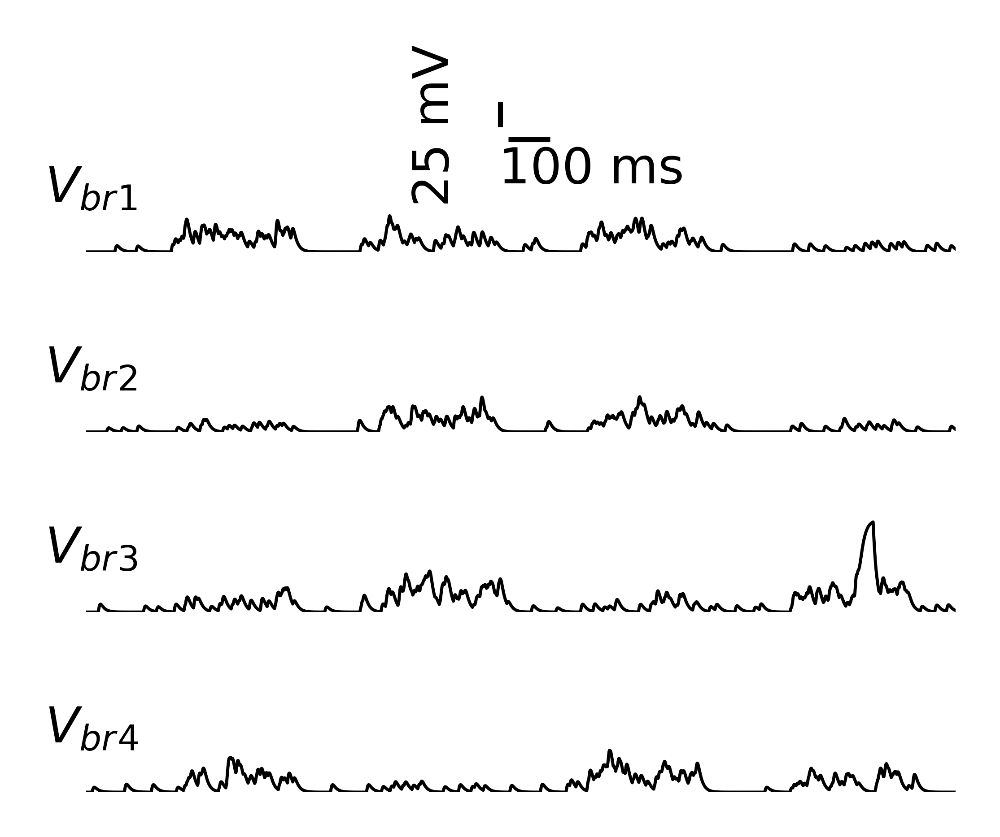

In [118]:
# branches_to_plot = [9,7,0,6] #[0,1,2,8]#
branches_to_plot = [5,10,0,9]

fig, axs = plt.subplots(len(branches_to_plot),figsize=(2.5,2.),dpi = 1000)


###########################branches
for plot_ind in range(len(branches_to_plot)):
    
        with open(f'results/{exp_name}/{exp_aspect}/{model_name}/{simulation_date}/{trial_number}/data/test_branch{branches_to_plot[plot_ind-1]}.0.mem', 'r') as f:
            data_observed = f.read().splitlines(True)

        potential_stick = [] 
        obsevation_time = []
        for component in data_observed[1:]:
                comps = component.split(' ')
                potential_stick.append(float(comps[1]))
                obsevation_time.append(float(comps[0]))

        obsevation_time = np.array(obsevation_time)
        axs[plot_ind].plot(obsevation_time,potential_stick,linewidth= 0.5,color = 'black')#,label = f'branch{plot_ind}')
        axs[plot_ind].text(-0.1,-30,'$V_{br}$'+f'$_{str(plot_ind+1)}$',fontsize = 8)
        # axs[plot_ind].text(-0.1,-40,'$V_{br}$',fontsize = 10)


# X-scale_bar
x_bar_start = 1.02
y_bar_pos = 20  # Slightly below x-axis
axs[0].hlines(y=y_bar_pos, xmin=x_bar_start, xmax=x_bar_start + 0.1, linewidth=0.8, color='black')
axs[0].text(x_bar_start + 0.2, y_bar_pos - 5, '100 ms', ha='center', va='top',fontsize = 8)
     
### Y_scale_bar
x_bar_pos = 1.0  # Slightly to the left of y-axis
y_bar_start = 30
axs[0].vlines(x=x_bar_pos, ymin=y_bar_start, ymax=y_bar_start + 25, linewidth=0.8, color='black')
axs[0].text(x_bar_pos - 0.1, y_bar_start + 1, '25 mV', rotation='vertical', va='center', ha='right',fontsize = 8)


#     ##########################Soma

# with open(f'results/{exp_name}/{exp_aspect}/{model_name}/{simulation_date}/{trial_number}/data/test_soma.0.mem', 'r') as f:
#     data_observed = f.read().splitlines(True)

# potential_stick = [] 
# obsevation_time = []
# for component in data_observed[1:]:
#         comps = component.split(' ')
#         potential_stick.append(float(comps[1]))
#         obsevation_time.append(float(comps[0]))

# obsevation_time = np.array(obsevation_time)
# axs[-1].plot(obsevation_time,potential_stick,linewidth= 0.5,color = 'black')#,label = f'branch{plot_ind}')
# axs[-1].text(-0.2,-50,'$V_{Soma}$',fontsize = 10)


### Print ticks
for i in range(len(branches_to_plot)): 
        axs[i].set_yticks([])#[-70,0, 70],['-70','0','70'])
        axs[i].set_xticks([])
        axs[i].spines['right'].set_visible(False)
        axs[i].spines['left'].set_visible(False)
        axs[i].spines['top'].set_visible(False)
        axs[i].spines['bottom'].set_visible(False)
    



# plt.text(0.5,0.5 , 'hello')
#### Set x and y limits
for i in range(len(branches_to_plot)):
    axs[i].set_xlim(0,2.1)
    axs[i].set_ylim(-70,50)

# fig.savefig("Figures/coactive2_V_trace.pdf", format='pdf')
fig.savefig("Figures/pdf/before_traces.pdf", format='pdf',bbox_inches='tight')
fig.savefig("Figures/pdf/before_trace.png", format='png',bbox_inches='tight')
# 
# fig.savefig("Figures/svg/"+exp_aspect+"_V_trace.svg", format='svg',bbox_inches='tight')

## Protocol and traces

In [70]:
# branches_to_plot = [9,7,0,6] #[0,1,2,8]#
branches_to_plot = [9,5,10,0]

fig, axs = plt.subplots(len(branches_to_plot)+2,figsize=(2.5,2.),dpi = 4000)

#############################Input
with open(f'results/{exp_name}/{exp_aspect}/{model_name}/{simulation_date}/{trial_number}/data/test_input.0.ras', 'r') as f:
    data_observed = f.read().splitlines(True)

active_cell = []
time_list=[]
color_list = []
assembely_colors_plotting = range(8)

for component in data_observed[1:]:
        comps = component.split(' ')
        active_cell.append(int(comps[1]))
        color_list.append(assembely_colors_plotting[int(active_cell[-1]/40)])
        time_list.append(float(comps[0]))
time_list = np.array(time_list)
d1 = {'cell_num': active_cell , 'time(s)': time_list,'color':color_list}

Activity_data_1 = pd.DataFrame(data=d1)

color_palette = "muted"
sns.scatterplot(ax=axs[0],data=Activity_data_1[Activity_data_1['color']<4], x="time(s)", y="cell_num",s = 1.3 ,hue = 'color', palette = color_palette,legend=False)
# axs[0].set_title('Test')
axs[0].set_ylabel("Input\ncell",fontsize = 8 , rotation = 90)
axs[0].set_xlabel("")
legend_handles = [Line2D([0], [0], marker='o', color='w', markerfacecolor=sns.color_palette(color_palette)[i], markersize=8, label=f'{i+1}') for i in range(8)]
# axs[0][1].legend(handles=legend_handles, loc='center', title='Assemblies', bbox_to_anchor=(0, 2), ncol=4)
# fig.legend(handles=legend_handles, loc='lower center', title='Assembly',bbox_to_anchor=(0.5, 0.91), ncol=4)

###########################branches
for plot_ind in range(1,len(branches_to_plot)+1):
    
        with open(f'results/{exp_name}/{exp_aspect}/{model_name}/{simulation_date}/{trial_number}/data/test_branch{branches_to_plot[plot_ind-1]}.0.mem', 'r') as f:
            data_observed = f.read().splitlines(True)

        potential_stick = [] 
        obsevation_time = []
        for component in data_observed[1:]:
                comps = component.split(' ')
                potential_stick.append(float(comps[1]))
                obsevation_time.append(float(comps[0]))

        obsevation_time = np.array(obsevation_time)
        axs[plot_ind].plot(obsevation_time,potential_stick,linewidth= 0.5,color = 'black')#,label = f'branch{plot_ind}')

#         axs[plot_ind].set_ylabel('$V_{branch}$'+str(plot_ind), rotation=90,fontsize = 5)

        axs[plot_ind].text(-0.1,-40,'$V_{br}$'+f'$_{str(plot_ind)}$',fontsize = 10)
        # axs[plot_ind].text(-0.1,-40,'$V_{br}$',fontsize = 10)


# X-scale_bar
x_bar_start = 1.0
y_bar_pos = -2  # Slightly below x-axis
axs[1].hlines(y=y_bar_pos, xmin=x_bar_start, xmax=x_bar_start + 0.1, linewidth=0.8, color='black')
axs[1].text(x_bar_start + 0.2, y_bar_pos - 5, '100 ms', ha='center', va='top',fontsize = 5)
     
### Y_scale_bar
x_bar_pos = 1.01  # Slightly to the left of y-axis
y_bar_start = 0
axs[1].vlines(x=x_bar_pos, ymin=y_bar_start, ymax=y_bar_start + 20, linewidth=0.8, color='black')
axs[1].text(x_bar_pos - 0.1, y_bar_start + 1, '20 mV', rotation='vertical', va='center', ha='right',fontsize = 5)


    ##########################Soma

with open(f'results/{exp_name}/{exp_aspect}/{model_name}/{simulation_date}/{trial_number}/data/test_soma.0.mem', 'r') as f:
    data_observed = f.read().splitlines(True)

potential_stick = [] 
obsevation_time = []
for component in data_observed[1:]:
        comps = component.split(' ')
        potential_stick.append(float(comps[1]))
        obsevation_time.append(float(comps[0]))

obsevation_time = np.array(obsevation_time)
axs[-1].plot(obsevation_time,potential_stick,linewidth= 0.5,color = 'black')#,label = f'branch{plot_ind}')
axs[-1].text(-0.2,-50,'$V_{Soma}$',fontsize = 10)


### Print ticks
for i in range(len(branches_to_plot)+2): 
    if i == 0:
        axs[i].set_yticks([])#[3,160,320],['0','160','320'])
        axs[i].set_xticks([])
        axs[i].spines['right'].set_visible(False)
        axs[i].spines['bottom'].set_visible(False)
        axs[i].spines['top'].set_visible(False)
    else: 
        axs[i].set_yticks([])#[-70,0, 70],['-70','0','70'])
        axs[i].set_xticks([])
        axs[i].spines['right'].set_visible(False)
        axs[i].spines['left'].set_visible(False)
        axs[i].spines['top'].set_visible(False)
        axs[i].spines['bottom'].set_visible(False)



#### Set x and y limits
for i in range(len(branches_to_plot)+2):
    axs[i].set_xlim(0,2.1)

axs[0].invert_yaxis()    
# fig.savefig("Figures/coactive2_V_trace.pdf", format='pdf')
fig.savefig("Figures/pdf/before.pdf", format='pdf',bbox_inches='tight')
fig.savefig("Figures/pdf/before.png", format='png',bbox_inches='tight')
# 
# fig.savefig("Figures/svg/"+exp_aspect+"_V_trace.svg", format='svg',bbox_inches='tight')

## After training

In [120]:
def main(simulation_time, experiment, sim_date, assemblies,
         assembly_neurons_idc, config, output_directory):

    input_params = config["input_parameters"]
    connection_params = config["connection_parameters"]
    neuron_params = config["neuron_parameters"]
#     input_params["pattern_duration"] = 0.7
    simulation_time_per_pattern = (input_params["pattern_duration"] +
                                   input_params["pattern_delay"])
    input_params['rate'] = 35 ### 35Hz
    input_params['num_simultaneous_assemblies'] = 1
    input_params['num_simultaneous_noise_assemblies'] = 1



    # Initialize the simulation environment.
    core.init(directory=output_directory)

    # Set the random seed.
    core.kernel.set_master_seed(config["master_seed"])

    # Create input neurons.
    inp = PoissonPatternGroup(input_params["num_inputs"], input_params["rate"],
                              input_params["rate_bg"], params=input_params)

    # Create the neuron.
    neuron = McLifGroup(1, neuron_params["num_branches"], neuron_params)

    # Connect input to neuron.
    conn = RewiringConnection(inp, neuron, neuron.branch.syn_current,
                              connection_params)
    conn.learn = False

    # Create some monitors which will record the simulation data.
    SpikeMonitor(neuron, core.kernel.fn("test_output", "ras"))
    SpikeMonitor(inp, core.kernel.fn("test_input", "ras"))
    VoltageMonitor(neuron.soma, 0, core.kernel.fn("test_soma", "mem"),
                   paste_spikes=True, paste_spikes_from=neuron)
    for i in range(neuron_params["num_branches"]):
        VoltageMonitor(neuron.branch, (i, 0),
                       core.kernel.fn("test_branch", "mem", i))

    # Now simulate the model.
#     conn.set_weights(weights_pre)
#     for assembly in assemblies:
#         inp.set_assemblies(assembly)
#         inp.set_assembly_neurons_idc(assembly_neurons_idc)
#         core.kernel.run_chunk(
#             simulation_time_per_pattern, 0, simulation_time)

    conn.set_weights(weights_post)
    for assembly in range(5):
        inp.set_assemblies(assembly)
        inp.set_assembly_neurons_idc(assembly_neurons_idc)
        core.kernel.run_chunk(
            simulation_time_per_pattern, 0, simulation_time)
        
#     for assembly in range(8):
#         inp.set_assemblies(assembly)
#         inp.set_assembly_neurons_idc(assembly_neurons_idc)
#         core.kernel.run_chunk(
#             simulation_time_per_pattern, 0, simulation_time)

    core.kernel.run_chunk(input_params["pattern_delay"], 0,
                               simulation_time)
# # #########coactive assemblies
#     conn.set_weights(weights_post)  
    
#     inp.set_assemblies([1,3])
#     inp.set_assembly_neurons_idc(assembly_neurons_idc)
#     core.kernel.run_chunk(simulation_time_per_pattern, 0, simulation_time)
        
#     inp.set_assemblies([2,4])
#     inp.set_assembly_neurons_idc(assembly_neurons_idc)
#     core.kernel.run_chunk(simulation_time_per_pattern, 0, simulation_time)
    

    
#     inp.set_assemblies([5,7])
#     inp.set_assembly_neurons_idc(assembly_neurons_idc)
#     core.kernel.run_chunk(simulation_time_per_pattern, 0, simulation_time)
    
#     inp.set_assemblies([0,2])
#     inp.set_assembly_neurons_idc(assembly_neurons_idc)
#     core.kernel.run_chunk(simulation_time_per_pattern, 0, simulation_time)
    
#         inp.set_assemblies([4,6])
#     inp.set_assembly_neurons_idc(assembly_neurons_idc)
#     core.kernel.run_chunk(simulation_time_per_pattern, 0, simulation_time)
    



#     core.kernel.run_chunk(input_params["pattern_delay"], 0,
#                                simulation_time)



if __name__ == '__main__':
    import numpy as np


    sim_date = f"{simulation_date}/{trial_number}"
    master_seed = 13
    simulation_time = 3.2

    assemblies = list(range(8))
    assembly_neurons_idc = [i * 40 + np.arange(40) for i in assemblies]

    input_directory = os.path.join("results", exp_name,exp_aspect,model_name, sim_date, "data")

    # Load the configuration file.
    config = utils.load_configuration(os.path.join(
        input_directory, "..", "config_" + exp_name + ".yaml"))
    num_branches = config["neuron_parameters"]["num_branches"]
    config["master_seed"] = master_seed
    if exp_name == "rewiring_ex3":
        assembly_neurons_idc = []
        assembly_neurons_idc = np.loadtxt(os.path.join(input_directory,
                                          "assembly_neurons_idc"),
                                          dtype=np.int)
    else:
        np.save(os.path.join(input_directory, "assembly_neurons_idc"),
                assembly_neurons_idc)

    # Load the weights.
    header_lenght = 3
    with open(os.path.join(input_directory, "weights.0.dat"), "rb") as f:
        lines = f.readlines()
    if ((len(lines)-2)%13) != 0 :
            lines = lines[:-((len(lines)-2)%13)]
    weights_pre = np.loadtxt(lines[header_lenght:num_branches + header_lenght])
    # weights_post = np.loadtxt(lines[header_lenght:num_branches + header_lenght])

    weights_post = np.loadtxt(lines[-num_branches:])

    main(simulation_time, exp_name, sim_date, assemblies,
         assembly_neurons_idc, config, input_directory)


Gidon_dendrites
Graded:  True
dendrite thr: -36.0
Soma thr: -55.0
[=====================>   ] 84%

## Voltage traces

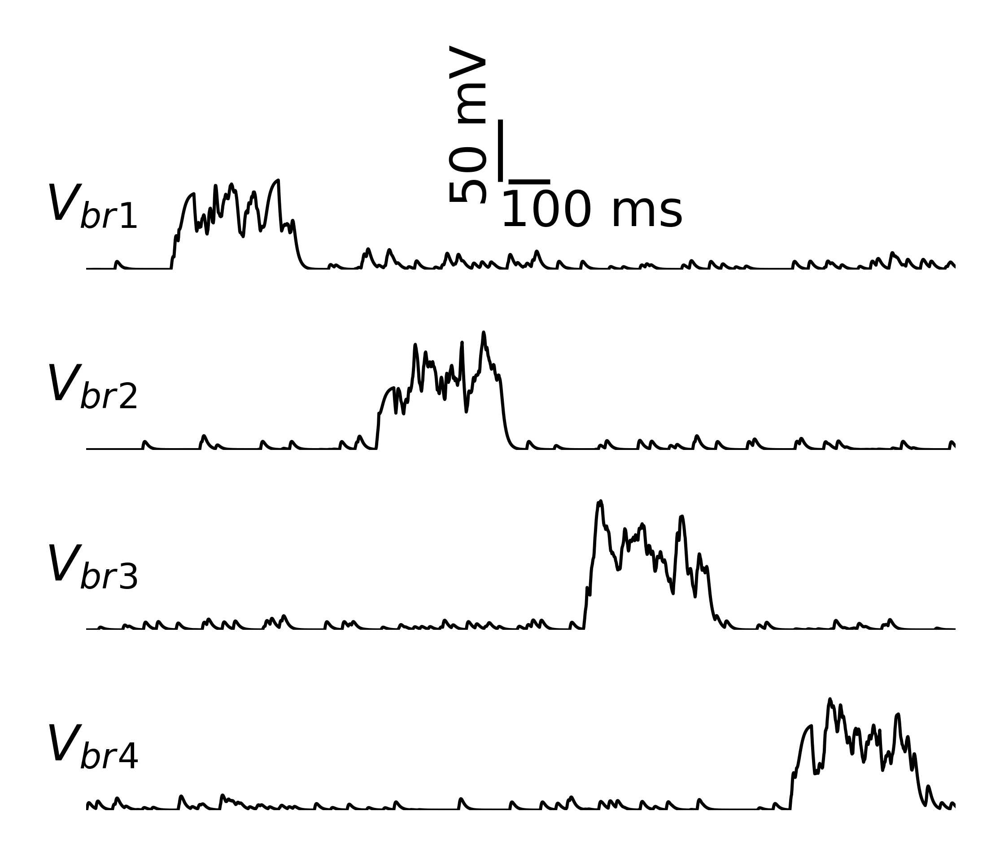

In [167]:
# branches_to_plot = [9,7,0,6] #[0,1,2,8]#
branches_to_plot = [5,10,0,9]

fig, axs = plt.subplots(len(branches_to_plot),figsize=(2.5,2.),dpi = 1000)


###########################branches
for plot_ind in range(len(branches_to_plot)):
    
        with open(f'results/{exp_name}/{exp_aspect}/{model_name}/{simulation_date}/{trial_number}/data/test_branch{branches_to_plot[plot_ind-1]}.0.mem', 'r') as f:
            data_observed = f.read().splitlines(True)

        potential_stick = [] 
        obsevation_time = []
        for component in data_observed[1:]:
                comps = component.split(' ')
                potential_stick.append(float(comps[1]))
                obsevation_time.append(float(comps[0]))

        obsevation_time = np.array(obsevation_time)
        axs[plot_ind].plot(obsevation_time,potential_stick,linewidth= 0.5,color = 'black')#,label = f'branch{plot_ind}')
        axs[plot_ind].text(-0.1,-30,'$V_{br}$'+f'$_{str(plot_ind+1)}$',fontsize = 8)
        # axs[plot_ind].text(-0.1,-40,'$V_{br}$',fontsize = 10)


# X-scale_bar
x_bar_start = 1.02
y_bar_pos = 0  # Slightly below x-axis
axs[0].hlines(y=y_bar_pos, xmin=x_bar_start, xmax=x_bar_start + 0.1, linewidth=0.8, color='black')
axs[0].text(x_bar_start + 0.2, y_bar_pos - 5, '100 ms', ha='center', va='top',fontsize = 8)
     
### Y_scale_bar
x_bar_pos = 1.0  # Slightly to the left of y-axis
y_bar_start = 0
axs[0].vlines(x=x_bar_pos, ymin=y_bar_start, ymax=y_bar_start + 50, linewidth=0.8, color='black')
axs[0].text(x_bar_pos - 0.01, y_bar_start + 45, '50 mV', rotation='vertical', va='center', ha='right',fontsize = 8)


#     ##########################Soma

# with open(f'results/{exp_name}/{exp_aspect}/{model_name}/{simulation_date}/{trial_number}/data/test_soma.0.mem', 'r') as f:
#     data_observed = f.read().splitlines(True)

# potential_stick = [] 
# obsevation_time = []
# for component in data_observed[1:]:
#         comps = component.split(' ')
#         potential_stick.append(float(comps[1]))
#         obsevation_time.append(float(comps[0]))

# obsevation_time = np.array(obsevation_time)
# axs[-1].plot(obsevation_time,potential_stick,linewidth= 0.5,color = 'black')#,label = f'branch{plot_ind}')
# axs[-1].text(-0.2,-50,'$V_{Soma}$',fontsize = 10)


### Print ticks
for i in range(len(branches_to_plot)): 
        axs[i].set_yticks([])#[-70,0, 70],['-70','0','70'])
        axs[i].set_xticks([])
        axs[i].spines['right'].set_visible(False)
        axs[i].spines['left'].set_visible(False)
        axs[i].spines['top'].set_visible(False)
        axs[i].spines['bottom'].set_visible(False)
    



# plt.text(0.5,0.5 , 'hello')
#### Set x and y limits
for i in range(len(branches_to_plot)):
    axs[i].set_xlim(0,2.1)
    axs[i].set_ylim(-70,50)

# fig.savefig("Figures/coactive2_V_trace.pdf", format='pdf')
fig.savefig("Figures/pdf/after_traces.pdf", format='pdf',bbox_inches='tight')
fig.savefig("Figures/pdf/after_trace.png", format='png',bbox_inches='tight')
# 
# fig.savefig("Figures/svg/"+exp_aspect+"_V_trace.svg", format='svg',bbox_inches='tight')

In [32]:
# branches_to_plot = [9,7,0,6] #[0,1,2,8]#
branches_to_plot = [9,5,10,0]

fig, axs = plt.subplots(len(branches_to_plot)+2,figsize=(2.5,3.5),dpi = 4000)

#############################Input
with open(f'results/{exp_name}/{exp_aspect}/{model_name}/{simulation_date}/{trial_number}/data/test_input.0.ras', 'r') as f:
    data_observed = f.read().splitlines(True)

active_cell = []
time_list=[]
color_list = []
assembely_colors_plotting = range(8)

for component in data_observed[1:]:
        comps = component.split(' ')
        active_cell.append(int(comps[1]))
        color_list.append(assembely_colors_plotting[int(active_cell[-1]/40)])
        time_list.append(float(comps[0]))
time_list = np.array(time_list)
d1 = {'cell_num': active_cell , 'time(s)': time_list,'color':color_list}

Activity_data_1 = pd.DataFrame(data=d1)

color_palette = "muted"
sns.scatterplot(ax=axs[0],data=Activity_data_1[Activity_data_1['color']<4], x="time(s)", y="cell_num",s = 1.3 ,hue = 'color', palette = color_palette,legend=False)
# axs[0].set_title('Test')
axs[0].set_ylabel("Input\ncell",fontsize = 8 , rotation = 90)
axs[0].set_xlabel("")
legend_handles = [Line2D([0], [0], marker='o', color='w', markerfacecolor=sns.color_palette(color_palette)[i], markersize=8, label=f'{i+1}') for i in range(8)]
# axs[0][1].legend(handles=legend_handles, loc='center', title='Assemblies', bbox_to_anchor=(0, 2), ncol=4)
# fig.legend(handles=legend_handles, loc='lower center', title='Assembly',bbox_to_anchor=(0.5, 0.91), ncol=4)

###########################branches
for plot_ind in range(1,len(branches_to_plot)+1):
    
        with open(f'results/{exp_name}/{exp_aspect}/{model_name}/{simulation_date}/{trial_number}/data/test_branch{branches_to_plot[plot_ind-1]}.0.mem', 'r') as f:
            data_observed = f.read().splitlines(True)

        potential_stick = [] 
        obsevation_time = []
        for component in data_observed[1:]:
                comps = component.split(' ')
                potential_stick.append(float(comps[1]))
                obsevation_time.append(float(comps[0]))

        obsevation_time = np.array(obsevation_time)
        axs[plot_ind].plot(obsevation_time,potential_stick,linewidth= 0.5,color = 'black')#,label = f'branch{plot_ind}')

#         axs[plot_ind].set_ylabel('$V_{branch}$'+str(plot_ind), rotation=90,fontsize = 5)

        axs[plot_ind].text(-0.1,-40,'$V_{br}$'+f'$_{str(plot_ind)}$',fontsize = 10)
        # axs[plot_ind].text(-0.1,-40,'$V_{br}$',fontsize = 10)


# X-scale_bar
x_bar_start = 1.0
y_bar_pos = -2  # Slightly below x-axis
axs[1].hlines(y=y_bar_pos, xmin=x_bar_start, xmax=x_bar_start + 0.1, linewidth=0.8, color='black')
axs[1].text(x_bar_start + 0.2, y_bar_pos - 5, '100 ms', ha='center', va='top',fontsize = 5)
     
### Y_scale_bar
x_bar_pos = 1.01  # Slightly to the left of y-axis
y_bar_start = 0
axs[1].vlines(x=x_bar_pos, ymin=y_bar_start, ymax=y_bar_start + 20, linewidth=0.8, color='black')
axs[1].text(x_bar_pos - 0.1, y_bar_start + 1, '20 mV', rotation='vertical', va='center', ha='right',fontsize = 5)


    ##########################Soma

with open(f'results/{exp_name}/{exp_aspect}/{model_name}/{simulation_date}/{trial_number}/data/test_soma.0.mem', 'r') as f:
    data_observed = f.read().splitlines(True)

potential_stick = [] 
obsevation_time = []
for component in data_observed[1:]:
        comps = component.split(' ')
        potential_stick.append(float(comps[1]))
        obsevation_time.append(float(comps[0]))

obsevation_time = np.array(obsevation_time)
axs[-1].plot(obsevation_time,potential_stick,linewidth= 0.5,color = 'black')#,label = f'branch{plot_ind}')
axs[-1].text(-0.2,-50,'$V_{Soma}$',fontsize = 10)


### Print ticks
for i in range(len(branches_to_plot)+2): 
    if i == 0:
        axs[i].set_yticks([])#[3,160,320],['0','160','320'])
        axs[i].set_xticks([])
        axs[i].spines['right'].set_visible(False)
        axs[i].spines['bottom'].set_visible(False)
        axs[i].spines['top'].set_visible(False)
    else: 
        axs[i].set_yticks([])#[-70,0, 70],['-70','0','70'])
        axs[i].set_xticks([])
        axs[i].spines['right'].set_visible(False)
        axs[i].spines['left'].set_visible(False)
        axs[i].spines['top'].set_visible(False)
        axs[i].spines['bottom'].set_visible(False)
        axs[i].set_ylim(-70,30)



#### Set x and y limits
for i in range(len(branches_to_plot)+2):
    axs[i].set_xlim(0,2.1)


axs[0].invert_yaxis()    
# fig.savefig("Figures/coactive2_V_trace.pdf", format='pdf')
fig.savefig("Figures/pdf/after.pdf", format='pdf',bbox_inches='tight')
fig.savefig("Figures/pdf/after.png", format='png',bbox_inches='tight')
# 
# fig.savefig("Figures/svg/"+exp_aspect+"_V_trace.svg", format='svg',bbox_inches='tight')